# Data Description

## 1. Importing Libraries

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns 
import matplotlib.pyplot as plt
%matplotlib inline 

import warnings
warnings.filterwarnings("ignore")

In [2]:
pd.set_option('display.max_columns',None)
pd.set_option('display.max_rows',None)
pd.set_option('display.precision', 3)

## 2. Importing Power Generation & Weather Sensor Data

In [3]:
generation_data = pd.read_csv('onboard_task/Plant_1_Generation_Data.csv')

In [4]:
weather_data = pd.read_csv('onboard_task/Plant_1_Weather_Sensor_Data.csv')

In [5]:
generation_data.sample(5).style.set_properties(
    **{
        'background-color': 'OliveDrab',
        'color': 'white',
        'border-color': 'darkblack'
    })

,DATE_TIME,PLANT_ID,SOURCE_KEY,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD
56197,12-06-2020 00:30,4135001,7JYdWkrLSPkdwr4,0.000000,0.000000,0.000000,7806664.000000
56463,12-06-2020 03:30,4135001,VHMLBKoKgIrUVDU,0.000000,0.000000,0.000000,7415011.000000
24634,27-05-2020 14:15,4135001,ZnxXDlPa8U1GXgE,4103.428571,403.057143,5115.000000,6617764.000000
2573,16-05-2020 09:00,4135001,VHMLBKoKgIrUVDU,6481.125000,634.887500,916.125000,7213582.125000
9338,19-05-2020 14:30,4135001,sjndEbLyjtCKgGv,10359.000000,1012.685714,5242.428571,7047647.429000


In [6]:
weather_data.sample(5).style.set_properties(
    **{
        'background-color': 'pink',
        'color': 'Black',
        'border-color': 'darkblack'
    })

,DATE_TIME,PLANT_ID,SOURCE_KEY,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION
627,2020-05-22 03:15:00,4135001,HmiyD2TTLFNqkNe,23.081620,21.352030,0.000000
2657,2020-06-12 12:45:00,4135001,HmiyD2TTLFNqkNe,27.122843,40.939669,0.544320
736,2020-05-23 07:45:00,4135001,HmiyD2TTLFNqkNe,23.517870,30.984898,0.269133
2143,2020-06-07 04:15:00,4135001,HmiyD2TTLFNqkNe,21.943726,20.334056,0.000000
1282,2020-05-29 00:30:00,4135001,HmiyD2TTLFNqkNe,21.008919,20.190776,0.000000


## 3. Adjust datetime format

In [7]:
generation_data['DATE_TIME'] = pd.to_datetime(generation_data['DATE_TIME'],format = '%d-%m-%Y %H:%M')
weather_data['DATE_TIME'] = pd.to_datetime(weather_data['DATE_TIME'],format = '%Y-%m-%d %H:%M:%S')

## 4. Merging generation data and weather sensor data

In [8]:
df_solar = pd.merge(generation_data.drop(columns = ['PLANT_ID']), weather_data.drop(columns = ['PLANT_ID', 'SOURCE_KEY']), on='DATE_TIME')
df_solar.sample(5).style.background_gradient(cmap='cool')

,DATE_TIME,SOURCE_KEY,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION
8835,2020-05-19 08:00:00,z9Y9gH1T5YWrNuG,1888.714286,185.000000,319.000000,7033892.000000,25.179372,30.782278,0.131212
20249,2020-05-25 12:00:00,VHMLBKoKgIrUVDU,12788.625000,1246.887500,4363.625000,7284875.625000,31.597302,58.968158,0.965226
45690,2020-06-07 01:00:00,sjndEbLyjtCKgGv,0.000000,0.000000,0.000000,7185656.000000,22.263181,20.769368,0.000000
18944,2020-05-24 20:30:00,iCRJl6heRkivqQ3,0.000000,0.000000,8041.000000,7251261.000000,26.938662,25.476503,0.000000
61630,2020-06-14 14:15:00,WRmjgnKYAwPKWDb,11647.428570,1136.771429,5661.285714,7252840.286000,28.222323,58.596647,0.910489


## 5. Adding separate time and date columns

In [9]:
# adding separate time and date columns
df_solar["DATE"] = pd.to_datetime(df_solar["DATE_TIME"]).dt.date
df_solar["TIME"] = pd.to_datetime(df_solar["DATE_TIME"]).dt.time
df_solar['DAY'] = pd.to_datetime(df_solar['DATE_TIME']).dt.day
df_solar['MONTH'] = pd.to_datetime(df_solar['DATE_TIME']).dt.month
df_solar['WEEK'] = pd.to_datetime(df_solar['DATE_TIME']).dt.week


# add hours and minutes for ml models
df_solar['HOURS'] = pd.to_datetime(df_solar['TIME'],format='%H:%M:%S').dt.hour
df_solar['MINUTES'] = pd.to_datetime(df_solar['TIME'],format='%H:%M:%S').dt.minute
df_solar['TOTAL MINUTES PASS'] = df_solar['MINUTES'] + df_solar['HOURS']*60

# add date as string column
df_solar["DATE_STRING"] = df_solar["DATE"].astype(str) # add column with date as string
df_solar["HOURS"] = df_solar["HOURS"].astype(str)
df_solar["TIME"] = df_solar["TIME"].astype(str)

df_solar.head(2)

,DATE_TIME,SOURCE_KEY,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,DATE,TIME,DAY,MONTH,WEEK,HOURS,MINUTES,TOTAL MINUTES PASS,DATE_STRING
0,2020-05-15,1BY6WEcLGh8j5v7,0.0,0.0,0.0,6.260e+06,25.184,22.858,0.0,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15
1,2020-05-15,1IF53ai7Xc0U56Y,0.0,0.0,0.0,6.184e+06,25.184,22.858,0.0,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15


In [10]:
df_solar.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 68774 entries, 0 to 68773
Data columns (total 18 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   DATE_TIME            68774 non-null  datetime64[ns]
 1   SOURCE_KEY           68774 non-null  object        
 2   DC_POWER             68774 non-null  float64       
 3   AC_POWER             68774 non-null  float64       
 4   DAILY_YIELD          68774 non-null  float64       
 5   TOTAL_YIELD          68774 non-null  float64       
 6   AMBIENT_TEMPERATURE  68774 non-null  float64       
 7   MODULE_TEMPERATURE   68774 non-null  float64       
 8   IRRADIATION          68774 non-null  float64       
 9   DATE                 68774 non-null  object        
 10  TIME                 68774 non-null  object        
 11  DAY                  68774 non-null  int64         
 12  MONTH                68774 non-null  int64         
 13  WEEK                 68774 non-

In [11]:
df_solar.isnull().sum()

DATE_TIME              0
SOURCE_KEY             0
DC_POWER               0
AC_POWER               0
DAILY_YIELD            0
TOTAL_YIELD            0
AMBIENT_TEMPERATURE    0
MODULE_TEMPERATURE     0
IRRADIATION            0
DATE                   0
TIME                   0
DAY                    0
MONTH                  0
WEEK                   0
HOURS                  0
MINUTES                0
TOTAL MINUTES PASS     0
DATE_STRING            0
dtype: int64

In [12]:
df_solar.describe().style.background_gradient(cmap='rainbow')

,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,DAY,MONTH,WEEK,MINUTES,TOTAL MINUTES PASS
count,68774.000000,68774.000000,68774.000000,68774.000000,68774.000000,68774.000000,68774.000000,68774.000000,68774.000000,68774.000000,68774.000000,68774.000000
mean,3147.177450,307.778375,3295.834644,6978727.511362,25.558521,31.244997,0.232305,15.762876,5.518539,22.549481,22.490621,716.515107
std,4036.441826,394.394865,3145.220597,416270.720885,3.361300,12.308283,0.301948,8.554460,0.499660,1.461138,16.772385,412.069969
min,0.000000,0.000000,0.000000,6183645.000000,20.398505,18.140415,0.000000,1.000000,5.000000,20.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,6512006.826000,22.724491,21.123944,0.000000,9.000000,5.000000,21.000000,0.000000,360.000000
50%,428.571429,41.450000,2658.473214,7146685.000000,24.670178,24.818984,0.031620,16.000000,6.000000,23.000000,15.000000,720.000000
75%,6365.468750,623.561161,6274.000000,7268751.397000,27.960429,41.693659,0.454880,23.000000,6.000000,24.000000,30.000000,1065.000000
max,14471.125000,1410.950000,9163.000000,7846821.000000,35.252486,65.545714,1.221652,31.000000,6.000000,25.000000,45.000000,1425.000000


## 6. Converting 'SOURCE_KEY' from categorical form to numerical form

In [13]:
from sklearn.preprocessing import LabelEncoder
encoder = LabelEncoder()
df_solar['SOURCE_KEY_NUMBER'] = encoder.fit_transform(df_solar['SOURCE_KEY'])
df_solar.head()

,DATE_TIME,SOURCE_KEY,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,DATE,TIME,DAY,MONTH,WEEK,HOURS,MINUTES,TOTAL MINUTES PASS,DATE_STRING,SOURCE_KEY_NUMBER
0,2020-05-15,1BY6WEcLGh8j5v7,0.0,0.0,0.0,6.260e+06,25.184,22.858,0.0,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15,0
1,2020-05-15,1IF53ai7Xc0U56Y,0.0,0.0,0.0,6.184e+06,25.184,22.858,0.0,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15,1
2,2020-05-15,3PZuoBAID5Wc2HD,0.0,0.0,0.0,6.988e+06,25.184,22.858,0.0,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15,2
3,2020-05-15,7JYdWkrLSPkdwr4,0.0,0.0,0.0,7.603e+06,25.184,22.858,0.0,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15,3
4,2020-05-15,McdE0feGgRqW7Ca,0.0,0.0,0.0,7.159e+06,25.184,22.858,0.0,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15,4


# Data Visualization

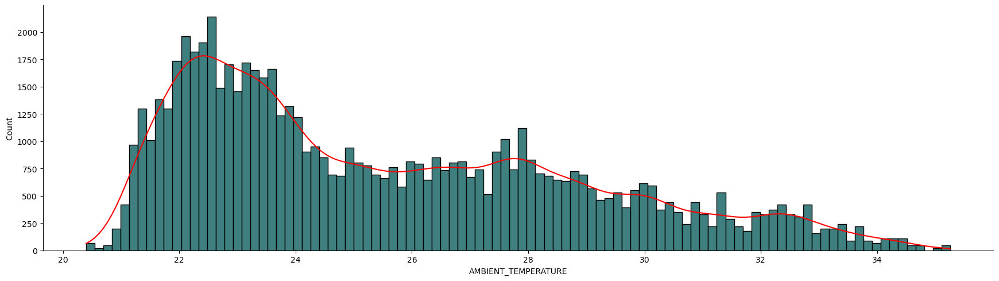

In [14]:
sns.displot(data=df_solar, x="AMBIENT_TEMPERATURE", kde=True, bins = 100,color = "red", facecolor = "#3F7F7F",height = 5, aspect = 3.5);

## 7. Multiple Plotting of DC_POWER generation on per day basis.

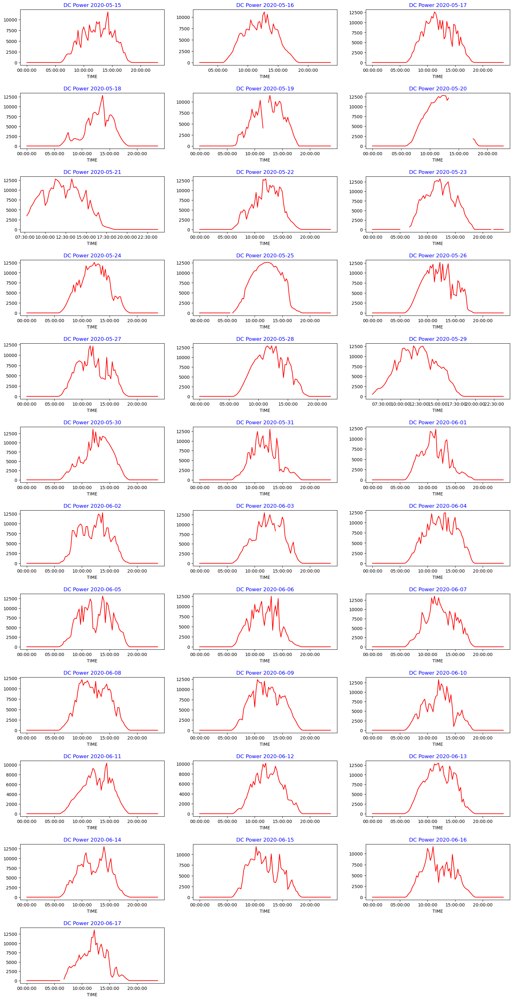

In [15]:
solar_dc = df_solar.pivot_table(values='DC_POWER', index='TIME', columns='DATE')

def Daywise_plot(data= None, row = None, col = None, title='DC Power'):
    cols = data.columns # take all column
    gp = plt.figure(figsize=(20,40)) 
    
    gp.subplots_adjust(wspace=0.2, hspace=0.5)
    for i in range(1, len(cols)+1):
        ax = gp.add_subplot(row,col, i)
        data[cols[i-1]].plot(ax=ax, color='red')
        ax.set_title('{} {}'.format(title, cols[i-1]),color='blue')
        
Daywise_plot(data=solar_dc, row=12, col=3)

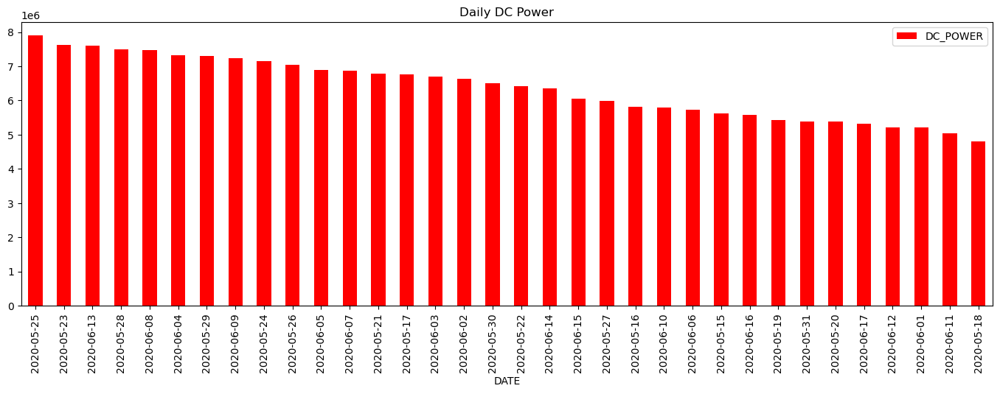

In [16]:
daily_dc = df_solar.groupby('DATE')['DC_POWER'].agg('sum')

ax = daily_dc.sort_values(ascending=False).plot.bar(figsize=(17,5), legend=True,color='red')
plt.title('Daily DC Power')
plt.show()

### Highest average DC_POWER Generation is on: 2020-05-25
### Lowest average DC_POWER Generation is on: 2020-05-18

## 8. Multiple Plotting of IRRADIATION generation on per day basis.

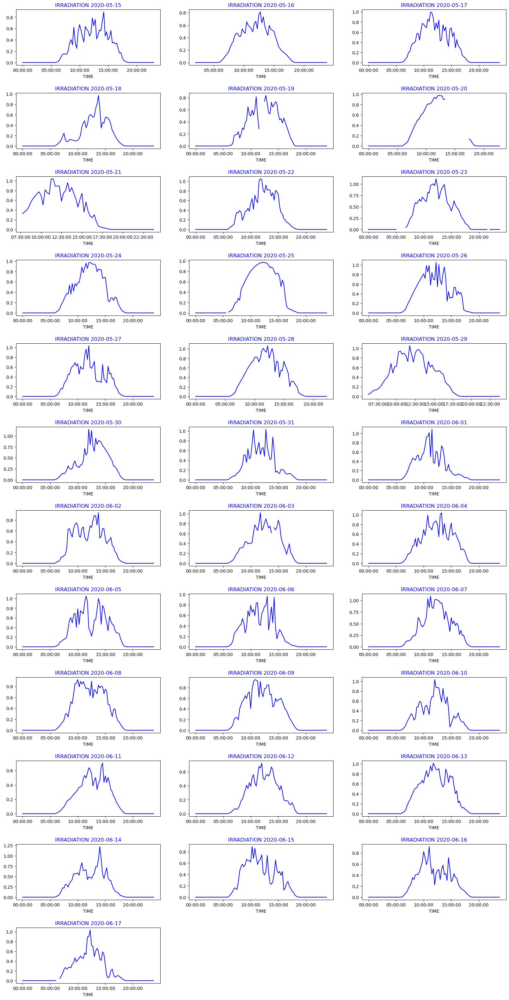

In [17]:
solar_irradiation = df_solar.pivot_table(values='IRRADIATION', index='TIME', columns='DATE')

def Daywise_plot(data= None, row = None, col = None, title='IRRADIATION'):
    cols = data.columns # take all column
    gp = plt.figure(figsize=(20,40)) 
    
    gp.subplots_adjust(wspace=0.2, hspace=0.5)
    for i in range(1, len(cols)+1):
        ax = gp.add_subplot(row,col, i)
        data[cols[i-1]].plot(ax=ax, color='blue')
        ax.set_title('{} {}'.format(title, cols[i-1]),color='blue')
        
Daywise_plot(data=solar_irradiation, row=12, col=3)

### IRRADIATION graph pattern is looking very similar to the corresponding DC_POWER generation on per day basis.

### In solar power plant DC_POWER or Output power is mostly depends on IRRADIATION .Or it is not wrong to say that it’s directly proportional.

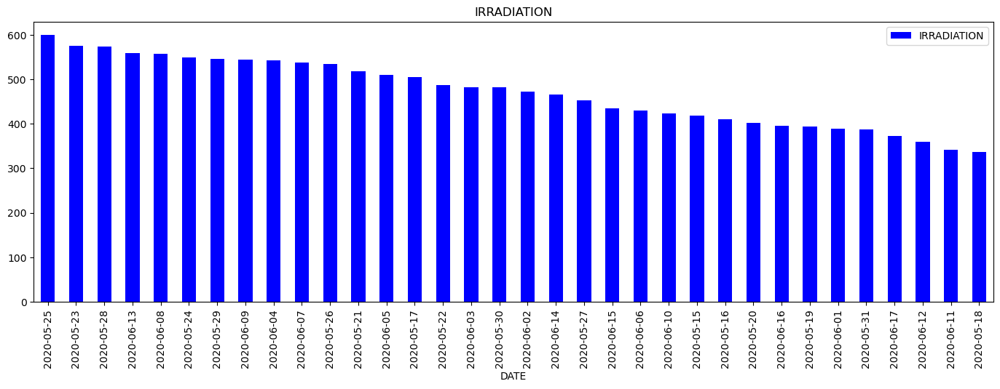

In [18]:
daily_irradiation = df_solar.groupby('DATE')['IRRADIATION'].agg('sum')

daily_irradiation.sort_values(ascending=False).plot.bar(figsize=(17,5), legend=True,color='blue')
plt.title('IRRADIATION')
plt.show()

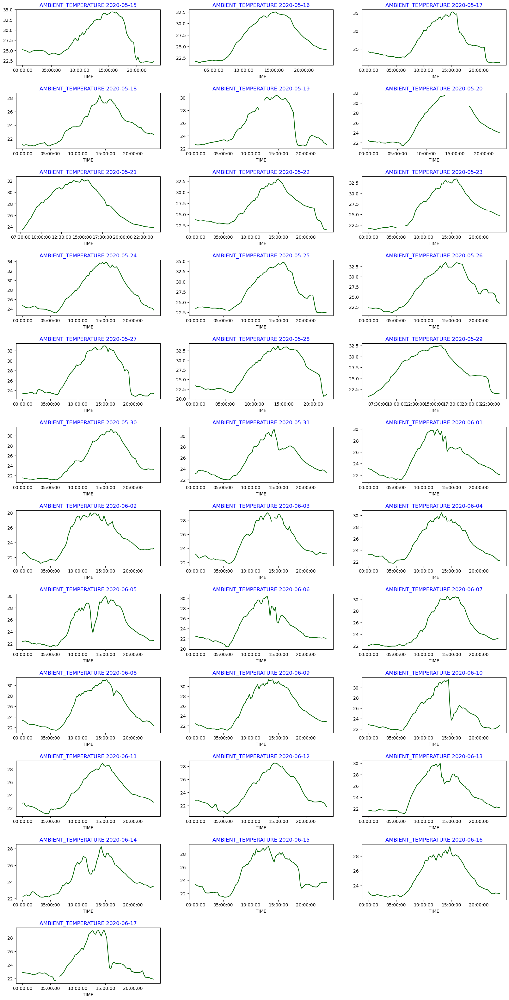

In [19]:
solar_ambiant_temp = df_solar.pivot_table(values='AMBIENT_TEMPERATURE', index='TIME', columns='DATE')

def Daywise_plot(data= None, row = None, col = None, title='AMBIENT_TEMPERATURE'):
    cols = data.columns # take all column
    gp = plt.figure(figsize=(20,40)) 
    
    gp.subplots_adjust(wspace=0.2, hspace=0.5)
    for i in range(1, len(cols)+1):
        ax = gp.add_subplot(row,col, i)
        data[cols[i-1]].plot(ax=ax, color='darkgreen')
        ax.set_title('{} {}'.format(title, cols[i-1]),color='blue')
        
Daywise_plot(data=solar_ambiant_temp, row=12, col=3)

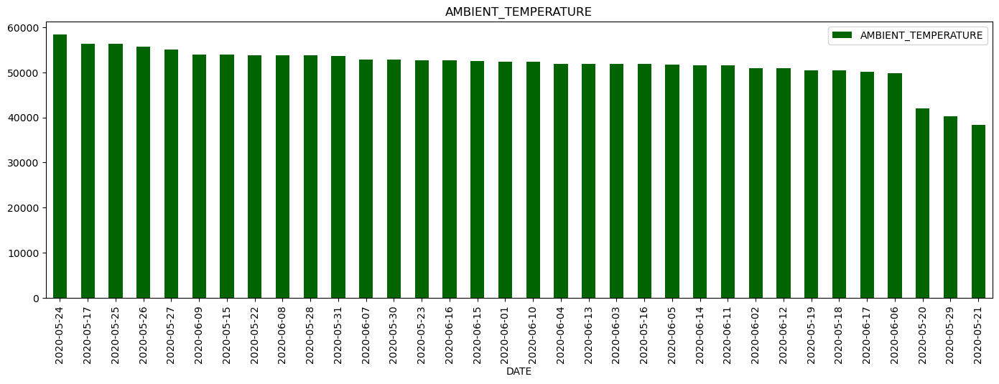

In [20]:
daily_ambient_temp = df_solar.groupby('DATE')['AMBIENT_TEMPERATURE'].agg('sum')

daily_ambient_temp.sort_values(ascending=False).plot.bar(figsize=(17,5), legend=True,color='darkgreen')
plt.title('AMBIENT_TEMPERATURE')
plt.show()

## Best and Worst Power generation comparision:

## 9. Highest average DC_POWER is generated on "2020-05-25"

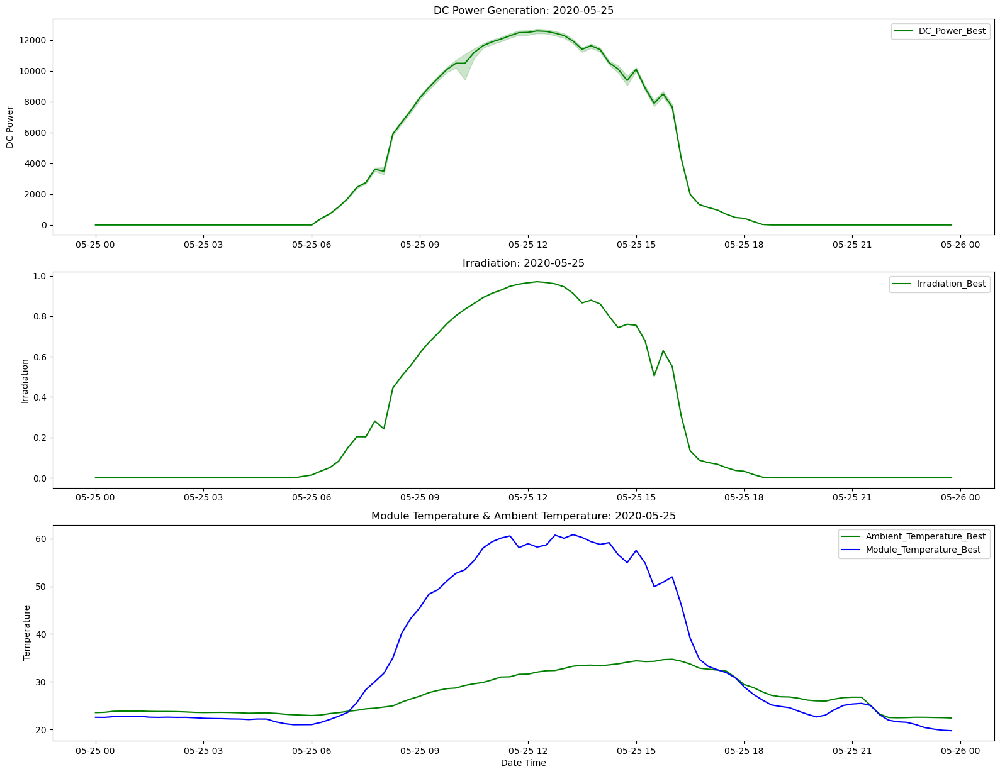

In [24]:
plt.figure(figsize=(16,16))

date=["2020-05-25"]

# plt.subplot(411)
# sns.lineplot(df_solar[df_solar["DATE_STRING"].isin(date)].DATE_TIME, df_solar[df_solar["DATE_STRING"].isin(date)].DC_POWER, label="DC_Power_Best",color='green');
# plt.title("DC Power Generation: {}" .format(date[0]))

plt.subplot(411)
sns.lineplot(x='DATE_TIME', y='DC_POWER', data=df_solar[df_solar["DATE_STRING"].isin(date)], label="DC_Power_Best", color='green')
plt.title("DC Power Generation: {}".format(date[0]))
plt.xlabel('')
plt.ylabel('DC Power')

# plt.subplot(412)
# sns.lineplot(df_solar[df_solar["DATE_STRING"].isin(date)].DATE_TIME, df_solar[df_solar["DATE_STRING"].isin(date)].IRRADIATION, label="Irridation_Best",color='green');
# plt.title("Irradiation : {}" .format(date[0]))

plt.subplot(412)
sns.lineplot(x='DATE_TIME', y='IRRADIATION', data=df_solar[df_solar["DATE_STRING"].isin(date)], label="Irradiation_Best", color='green')
plt.title("Irradiation: {}".format(date[0]))
plt.xlabel('')
plt.ylabel('Irradiation')

# plt.subplot(413)
# sns.lineplot(df_solar[df_solar["DATE_STRING"].isin(date)].DATE_TIME, df_solar[df_solar["DATE_STRING"].isin(date)].AMBIENT_TEMPERATURE, label="Ambient_Temperature_Best",color='green');
# sns.lineplot(df_solar[df_solar["DATE_STRING"].isin(date)].DATE_TIME, df_solar[df_solar["DATE_STRING"].isin(date)].MODULE_TEMPERATURE, label="Module_Temperature_Best",color='blue');
# plt.title("Module Temperature & Ambient Temperature: {}" .format(date[0]));

# Subplot for Ambient Temperature and Module Temperature
plt.subplot(413)
sns.lineplot(x='DATE_TIME', y='AMBIENT_TEMPERATURE', data=df_solar[df_solar["DATE_STRING"].isin(date)], label="Ambient_Temperature_Best", color='green')
sns.lineplot(x='DATE_TIME', y='MODULE_TEMPERATURE', data=df_solar[df_solar["DATE_STRING"].isin(date)], label="Module_Temperature_Best", color='blue')
plt.title("Module Temperature & Ambient Temperature: {}".format(date[0]))
plt.xlabel('Date Time')
plt.ylabel('Temperature')

plt.tight_layout()
plt.show()

### NOTE: Both DC_POWER graph and IRRADIATION graph is almost looking like an ideal graph which is explained earlier. Weather is also looking good, and there is no cloud is in the sky because there is very less variation in IRRADIATION and temperature of the solar panel and ambient temperature.

## 10. Lowest average DC_POWER is generated on "2020-05-18"

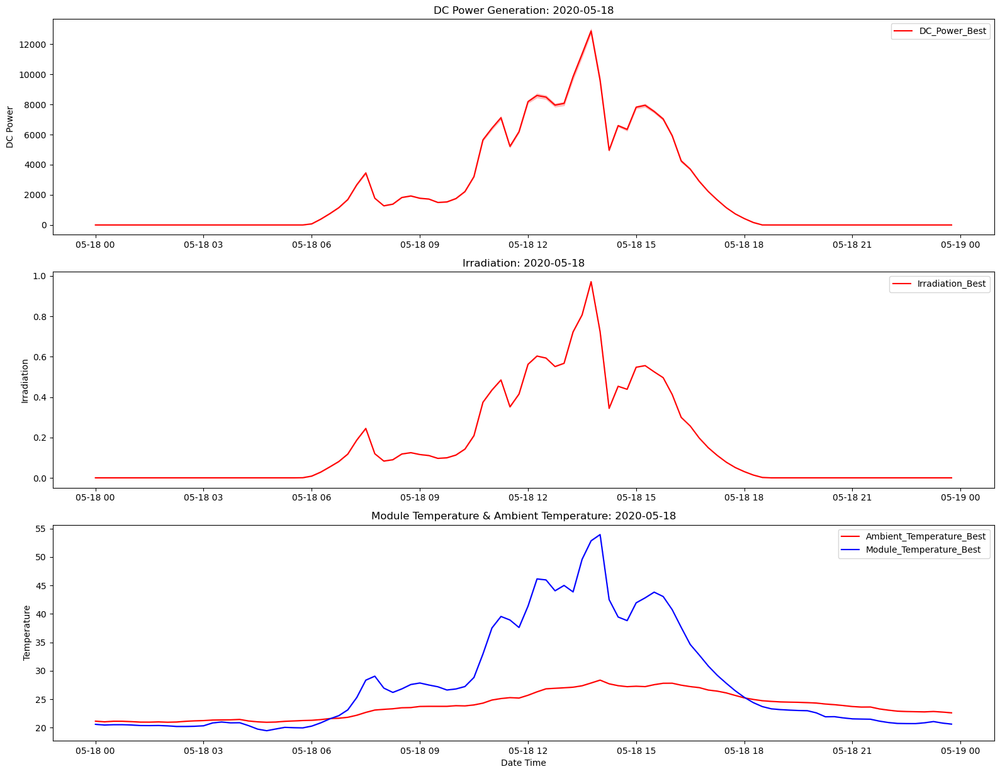

In [26]:
date=["2020-05-18"]
plt.figure(figsize=(16,16))

plt.subplot(411)
sns.lineplot(x='DATE_TIME', y='DC_POWER', data=df_solar[df_solar["DATE_STRING"].isin(date)], label="DC_Power_Best", color='red')
plt.title("DC Power Generation: {}".format(date[0]))
plt.xlabel('')
plt.ylabel('DC Power')

plt.subplot(412)
sns.lineplot(x='DATE_TIME', y='IRRADIATION', data=df_solar[df_solar["DATE_STRING"].isin(date)], label="Irradiation_Best", color='red')
plt.title("Irradiation: {}".format(date[0]))
plt.xlabel('')
plt.ylabel('Irradiation')

plt.subplot(413)
sns.lineplot(x='DATE_TIME', y='AMBIENT_TEMPERATURE', data=df_solar[df_solar["DATE_STRING"].isin(date)], label="Ambient_Temperature_Best", color='red')
sns.lineplot(x='DATE_TIME', y='MODULE_TEMPERATURE', data=df_solar[df_solar["DATE_STRING"].isin(date)], label="Module_Temperature_Best", color='blue')
plt.title("Module Temperature & Ambient Temperature: {}".format(date[0]))
plt.xlabel('Date Time')
plt.ylabel('Temperature')

plt.tight_layout()
plt.show()

## Solar Power Plant Inverter Efficiency Calculation

In [27]:
solar_dc_power = df_solar[df_solar['DC_POWER'] > 0]['DC_POWER'].values
solar_ac_power = df_solar[df_solar['AC_POWER'] > 0]['AC_POWER'].values

In [30]:
len(solar_dc_power)

36823

In [31]:
len(solar_ac_power)

36823

In [34]:
np.min(solar_ac_power)

0.85

In [35]:
np.min(solar_dc_power)

8.75

In [28]:
solar_plant_eff = (np.max(solar_ac_power)/np.max(solar_dc_power ))*100
print(f"Power ratio AC/DC (Efficiency) of Solar Power Plant:  {solar_plant_eff:0.3f} %")

Power ratio AC/DC (Efficiency) of Solar Power Plant:  9.750 %


In [36]:
AC_list=[]
for i in df_solar['AC_POWER']:
    if i>0:
        AC_list.append(i)
AC_list
#AC_list.sort()
#AC_list.reverse()
len(AC_list)

36823

In [37]:
#Here we take all nonzero DC values and plot them on histogram
DC_list=[]
for i in df_solar['DC_POWER']:
    if i>0:
        DC_list.append(i)
DC_list
DC_list.sort()
DC_list.reverse()
len(DC_list)

36823

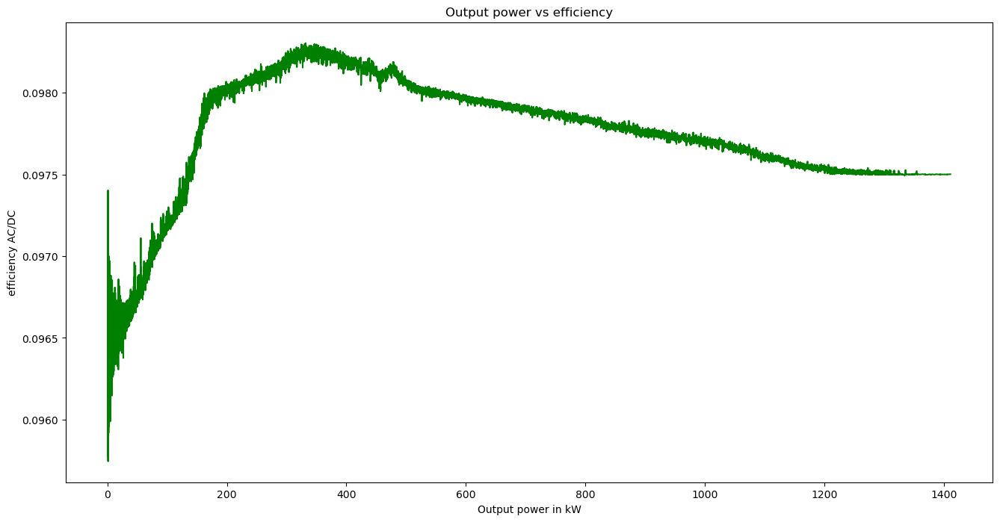

In [38]:
plt.figure(figsize=(16,8))
AC_list.sort()
DC_list.sort()
#print(DC_list)
#DC_list.sort
#res = [i / 10 for i in AC_list]
eff = [i/j for i,j in zip(AC_list,DC_list)]

plt.plot(AC_list,eff,color='green')
plt.xlabel('Output power in kW')
plt.ylabel('efficiency AC/DC')
plt.title('Output power vs efficiency');

## Solar Power Prediction

In [39]:
df2 = df_solar.copy()
X = df2[['DAILY_YIELD','TOTAL_YIELD','AMBIENT_TEMPERATURE','MODULE_TEMPERATURE','IRRADIATION','DC_POWER']]
y = df2['AC_POWER']

In [40]:
X.head()

,DAILY_YIELD,TOTAL_YIELD,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,DC_POWER
0,0.0,6.260e+06,25.184,22.858,0.0,0.0
1,0.0,6.184e+06,25.184,22.858,0.0,0.0
2,0.0,6.988e+06,25.184,22.858,0.0,0.0
3,0.0,7.603e+06,25.184,22.858,0.0,0.0
4,0.0,7.159e+06,25.184,22.858,0.0,0.0


In [41]:
y.head()

0    0.0
1    0.0
2    0.0
3    0.0
4    0.0
Name: AC_POWER, dtype: float64

In [42]:
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=.2,random_state=21)

## 1. LinearRegression

In [43]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

lr_clf = LinearRegression()
lr_clf.fit(X_train,y_train)
score_lr = 100*lr_clf.score(X_test,y_test)
print(f'LR Model score = {score_lr:4.4f}%')

LR Model score = 99.9995%


In [44]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

lr = LinearRegression()
lr.fit(X_train,y_train)
y_pred_lr = lr.predict(X_test)
R2_Score_lr = round(r2_score(y_pred_lr,y_test) * 100, 2)

print("R2 Score : ",R2_Score_lr,"%")

R2 Score :  100.0 %


## 2. RandomForestRegressor

In [45]:
from sklearn.ensemble import RandomForestRegressor
rfr = RandomForestRegressor()
rfr.fit(X_train,y_train)
y_pred_rfr = rfr.predict(X_test)
R2_Score_rfr = round(r2_score(y_pred_rfr,y_test) * 100, 2)

print("R2 Score : ",R2_Score_rfr,"%")

R2 Score :  100.0 %


## 3. DecisionTreeRegressor

In [46]:
from sklearn.tree import DecisionTreeRegressor
dtr = DecisionTreeRegressor()
dtr.fit(X_train,y_train)

y_pred_dtr = rfr.predict(X_test)
R2_Score_dtr = round(r2_score(y_pred_dtr,y_test) * 100, 2)

print("R2 Score : ",R2_Score_dtr,"%")

R2 Score :  100.0 %


## 11. Result Prediction

In [47]:
prediction = rfr.predict(X_test)
print(prediction)

[   0.         1071.40121437  299.65239286 ...  669.38992857  377.83526785
  117.48841072]


In [48]:
cross_checking = pd.DataFrame({'Actual' : y_test , 'Predicted' : prediction})
cross_checking.head()

,Actual,Predicted
43819,0.000,0.000
2949,1072.325,1071.401
33769,299.812,299.652
47825,0.000,0.000
29370,0.000,0.000


In [49]:
cross_checking['Error'] = cross_checking['Actual'] - cross_checking['Predicted']
cross_checking.head()

,Actual,Predicted,Error
43819,0.000,0.000,0.000
2949,1072.325,1071.401,0.924
33769,299.812,299.652,0.160
47825,0.000,0.000,0.000
29370,0.000,0.000,0.000


In [50]:
cross_checking_final  = cross_checking[cross_checking['Error'] <= 20]
cross_checking_final.sample(25).style.background_gradient(
        cmap='coolwarm').set_properties(**{
            'font-family': 'Lucida Calligraphy',
            'color': 'LigntGreen',
            'font-size': '15px'
        })

,Actual,Predicted,Error
1888,0.000000,0.000000,0.000000
8310,0.000000,0.000000,0.000000
41079,0.000000,0.000000,0.000000
35198,0.000000,0.000000,0.000000
33933,570.525000,570.480071,0.044929
22607,444.500000,444.390357,0.109643
25965,14.562500,14.580214,-0.017714
23090,0.000000,0.000000,0.000000
47708,0.000000,0.000000,0.000000
67680,762.385714,762.085536,0.300179


## Exploratory Data Analysis

In [51]:
generation_data = pd.read_csv('onboard_task/Plant_1_Generation_Data.csv')
weather_data = pd.read_csv('onboard_task/Plant_1_Weather_Sensor_Data.csv')

generation_data['DATE_TIME'] = pd.to_datetime(generation_data['DATE_TIME'],format = '%d-%m-%Y %H:%M')
weather_data['DATE_TIME'] = pd.to_datetime(weather_data['DATE_TIME'],format = '%Y-%m-%d %H:%M:%S')
df = pd.merge(generation_data.drop(columns = ['PLANT_ID']), weather_data.drop(columns = ['PLANT_ID', 'SOURCE_KEY']), on='DATE_TIME')
df.head()

,DATE_TIME,SOURCE_KEY,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION
0,2020-05-15,1BY6WEcLGh8j5v7,0.0,0.0,0.0,6.260e+06,25.184,22.858,0.0
1,2020-05-15,1IF53ai7Xc0U56Y,0.0,0.0,0.0,6.184e+06,25.184,22.858,0.0
2,2020-05-15,3PZuoBAID5Wc2HD,0.0,0.0,0.0,6.988e+06,25.184,22.858,0.0
3,2020-05-15,7JYdWkrLSPkdwr4,0.0,0.0,0.0,7.603e+06,25.184,22.858,0.0
4,2020-05-15,McdE0feGgRqW7Ca,0.0,0.0,0.0,7.159e+06,25.184,22.858,0.0


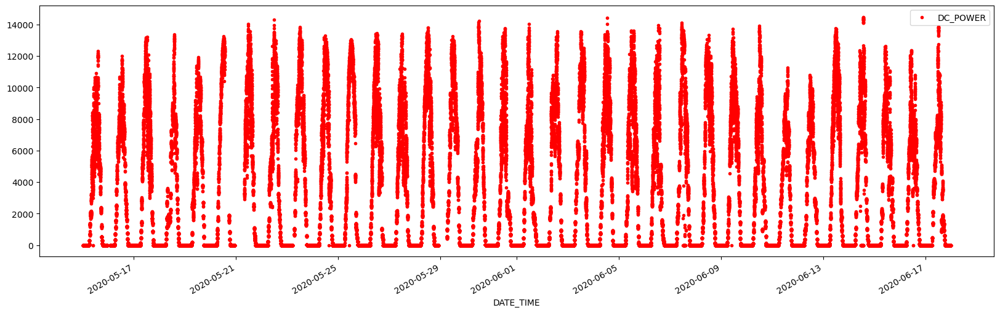

In [52]:
df.plot(x= 'DATE_TIME', y='DC_POWER', style='.', figsize = (20, 6),color= "red");

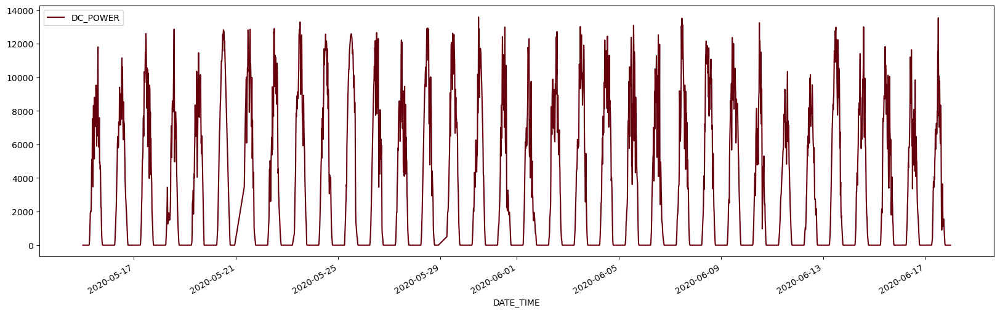

In [54]:
df.groupby('DATE_TIME')['DC_POWER'].agg('mean').plot(legend=True, colormap='Reds_r',figsize = (20, 6));

In [55]:
import plotly.graph_objects as go
import plotly.express as px
from plotly.offline import iplot

data = go.Bar(x = df.groupby('SOURCE_KEY').agg({'TOTAL_YIELD':'mean'}). \
              reset_index()['SOURCE_KEY'],
              y = df.groupby('SOURCE_KEY').agg({'TOTAL_YIELD':'mean'}). \
              reset_index()['TOTAL_YIELD'],
              width=[0.5, 0.5],
              text =round(df.groupby('SOURCE_KEY').agg({'TOTAL_YIELD':'mean'}).reset_index()['TOTAL_YIELD'],2),
              textposition= 'outside',
              textfont = dict(size = 26,
                             color = 'deeppink'),
              marker = dict(color = 'pink',
                            line_color = 'deeppink',
                            line_width = 3,
                            opacity = 0.65))

layout = go.Layout(title = {'text': "Avg TOTAL_YIELD by SOURCE_KEY",
                           'y':1.0,
                           'x':0.5,
                           'xanchor': 'center',
                           'yanchor': 'top'},
                   xaxis = dict(title = 'SOURCE_KEY'),
                   yaxis =dict(title = 'TOTAL_YIELD'),
                   width = 1400,
                   height = 700,
                   template = 'simple_white')

fig=go.Figure(data = data, layout = layout)
iplot(fig)

In [56]:
import plotly.express as px
fig = px.sunburst(df, path=['SOURCE_KEY'], values='DAILY_YIELD',color='MODULE_TEMPERATURE')
fig.update_layout (height = 800 , width = 800)
fig.show()

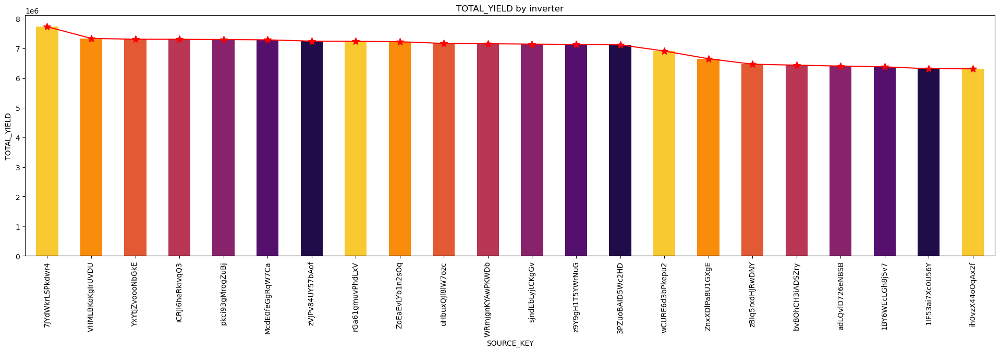

In [57]:
plt.figure(figsize=(24,6))
plt.title('TOTAL_YIELD by inverter')
plt.ylabel('TOTAL_YIELD')
df.groupby('SOURCE_KEY')['TOTAL_YIELD'].mean().sort_values(ascending=False).plot(kind='line', marker='*', color='red', ms=10)
df.groupby('SOURCE_KEY')['TOTAL_YIELD'].mean().sort_values(ascending=False).plot(kind='bar',color=sns.color_palette("inferno_r", 7))
plt.show()

In [58]:
import plotly.graph_objects as go
import plotly.express as px

labels = df['SOURCE_KEY']
values =df['TOTAL_YIELD']
fig = go.Figure(data = [go.Pie(labels = labels , values = values , 
         textinfo = 'label+percent' , hole =0.3, pull = [.1, 0, 0, 0])])
fig.show()

In [59]:
import plotly.express as px
import plotly.graph_objs as go

fig = px.scatter(df, x = 'DAILY_YIELD', y = 'IRRADIATION', log_x=True,
                 hover_name="SOURCE_KEY", hover_data=["DAILY_YIELD", "IRRADIATION"],
                color = 'DAILY_YIELD', color_continuous_scale= 'rainbow',
                title = 'Quality or Quantity, That\'s the question')
fig.show()

In [60]:
import plotly.express as px
import plotly.graph_objs as go

dfpie = df.loc[df.groupby('SOURCE_KEY')['AMBIENT_TEMPERATURE'].idxmax()]
fig = px.bar(dfpie, x = 'SOURCE_KEY', y = 'AMBIENT_TEMPERATURE',
            text = 'SOURCE_KEY', color = 'DAILY_YIELD',
            title = 'Max AMBIENT_TEMPERATURE')
fig.show()

In [61]:
df['SOURCE_KEY'].value_counts()

bvBOhCH3iADSZry    3155
1BY6WEcLGh8j5v7    3154
7JYdWkrLSPkdwr4    3133
VHMLBKoKgIrUVDU    3133
ZnxXDlPa8U1GXgE    3130
ih0vzX44oOqAx2f    3130
z9Y9gH1T5YWrNuG    3125
wCURE6d3bPkepu2    3125
uHbuxQJl8lW7ozc    3125
pkci93gMrogZuBj    3125
iCRJl6heRkivqQ3    3125
rGa61gmuvPhdLxV    3124
sjndEbLyjtCKgGv    3124
McdE0feGgRqW7Ca    3124
zVJPv84UY57bAof    3124
ZoEaEvLYb1n2sOq    3123
zBIq5rxdHJRwDNY    3119
1IF53ai7Xc0U56Y    3118
adLQvlD726eNBSB    3118
WRmjgnKYAwPKWDb    3118
3PZuoBAID5Wc2HD    3118
YxYtjZvoooNbGkE    3104
Name: SOURCE_KEY, dtype: int64

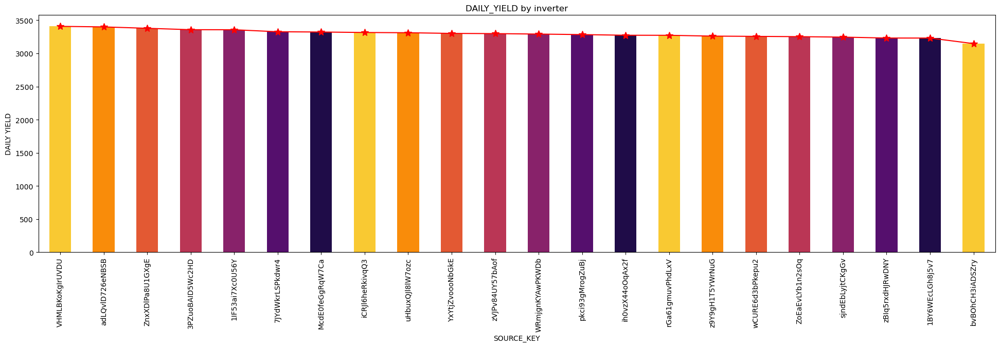

In [62]:
plt.figure(figsize=(24,6))
plt.title('DAILY_YIELD by inverter')
plt.ylabel('DAILY YIELD')
df.groupby('SOURCE_KEY')['DAILY_YIELD'].mean().sort_values(ascending=False).plot(kind='line', marker='*', color='red', ms=10)
df.groupby('SOURCE_KEY')['DAILY_YIELD'].mean().sort_values(ascending=False).plot(kind='bar',color=sns.color_palette("inferno_r", 7))
plt.show()

,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION
DATE_TIME,,,,,,,
2020-05-15,2879.856,281.899,2586.280,6.856e+06,27.577,33.057,0.214
2020-05-16,3002.139,293.878,3464.273,6.863e+06,26.786,31.871,0.212


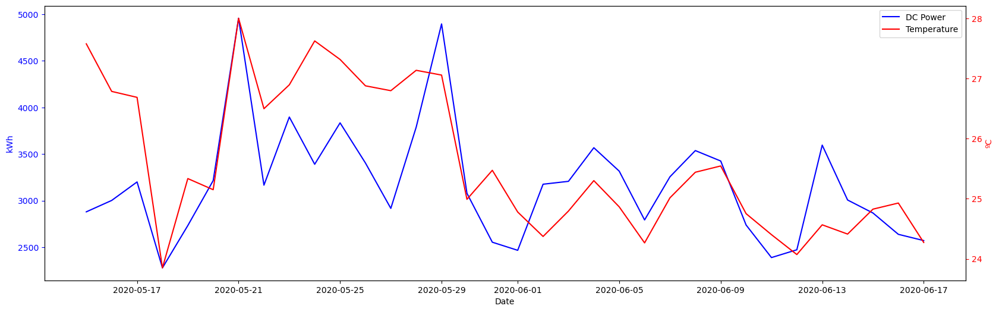

In [64]:
df1 = df.set_index('DATE_TIME')
daily_data = df1.resample('24h').mean()
display(daily_data.head(2))

fig, ax1 = plt.subplots(figsize=(20,6))
ax1.plot(daily_data.index, daily_data['DC_POWER'], 'b', label='DC Power')
ax1.set_xlabel('Date')
ax1.set_ylabel('kWh', color='b')
ax1.tick_params('y', colors='b')

ax2 = ax1.twinx()

ax2.plot(daily_data.index, daily_data['AMBIENT_TEMPERATURE'], 'r', label='Temperature')
ax2.set_ylabel('ºC', color='r')
ax2.tick_params('y', colors='r')

lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
lines = lines1 + lines2
labels = labels1 + labels2
ax1.legend(lines, labels, loc='upper right')
plt.show()

In [65]:
import plotly.express as px
import plotly.graph_objs as go

dfpie = df1.groupby('SOURCE_KEY')['DAILY_YIELD'].count()
fig = px.pie(values=dfpie.values, names=dfpie.index, 
            title = 'Proportional Analysis of DAILY_YIELD with SOURCE_KEY')
fig.show()

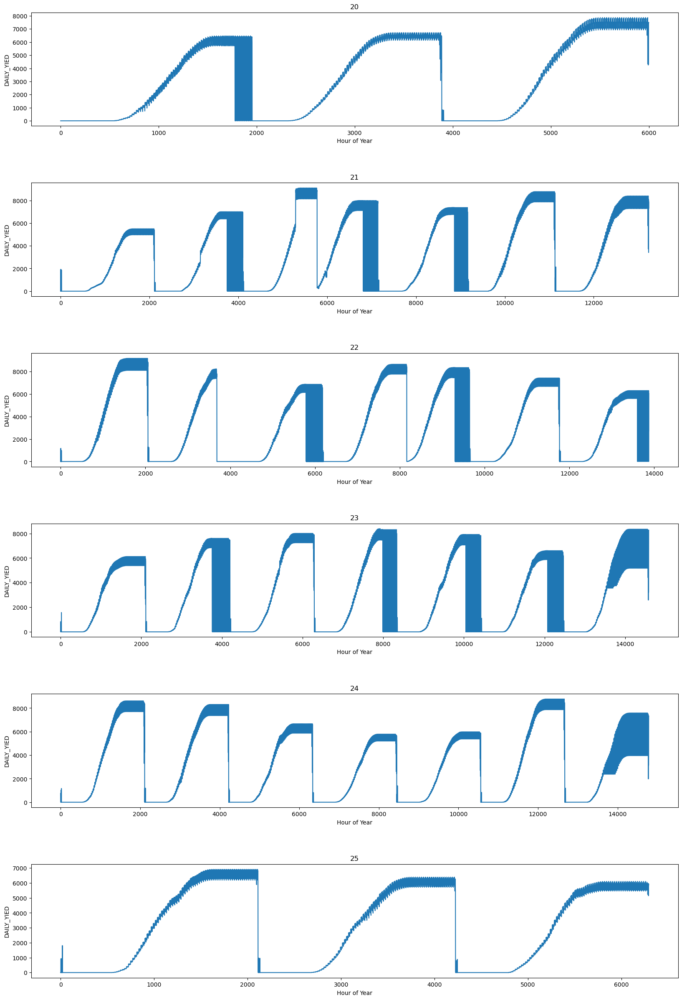

In [66]:
#group data by week
groups = df1['DAILY_YIELD'].groupby(pd.Grouper(freq='W'))

#set figure and axis
fig, axs = plt.subplots(len(groups), 1, figsize=(20,30))
for ax, (name, group) in zip(axs, groups):
    
    #plot the data
    ax.plot(pd.Series(group.values))

    ax.set_xlabel('Hour of Year')
    ax.set_ylabel('DAILY_YIED')
    ax.set_title(name.week)
    plt.subplots_adjust(hspace=0.5)

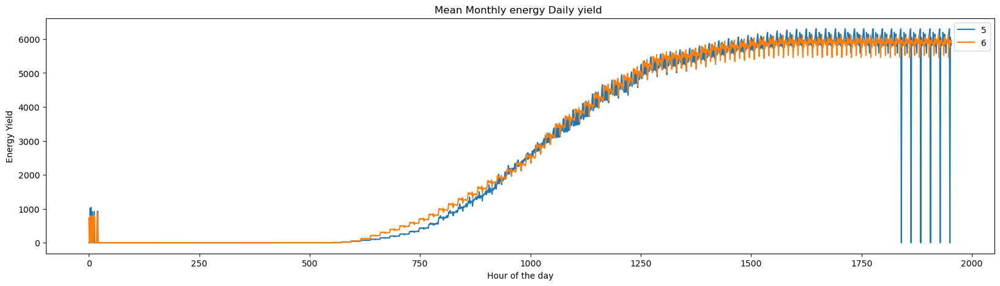

In [67]:
group_hours = df1['DAILY_YIELD'].groupby(pd.Grouper(freq='D', how='mean'))

fig, axs = plt.subplots(1,1, figsize=(20,5))

year_demands = pd.DataFrame()
    
for name, group in group_hours:
    year_demands[name.month] = pd.Series(group.values)
    
year_demands.plot(ax=axs)
axs.set_xlabel('Hour of the day')
axs.set_ylabel('Energy Yield')
axs.set_title('Mean Monthly energy Daily yield ');